In [1]:
# Graph Managment
import graph_tool.all as gt
import networkx as nx
import numpy as np

# Data Visualization
from matplotlib.patches import ArrowStyle
from matplotlib.patches import Ellipse
import seaborn as sns
import matplotlib.pyplot as plt
from PIL import Image
from IPython.display import Image as IPImage

from utils.Bojanowski import get_types_array
from time import perf_counter
import io
from glob import glob
from tqdm import tqdm
from concurrent.futures import ProcessPoolExecutor

/mnt/disk2/anaconda3/envs/gt_global/lib/python3.11/site-packages/graph_tool/draw/cairo_draw.py:1544: RuntimeWarning: Error importing Gtk module: ; GTK+ drawing will not work.
  warnings.warn(msg, RuntimeWarning)


In [2]:
# Prerequistes, are usually constant could change 
pos_label = {
    0: (-2.5,-0.3),
    1: (2.5,-0.3),
    2: (0,2.5),
    3: (0,-2.5)
}
pos = {
    0: (-2,0),
    1: (2,0),
    2: (0,2),
    3: (0,-2)
}


In [12]:
(2.5-2)/2

0.25

In [67]:
def posiciones(n,elongar_label=0.45):
    coeficientes = [1] + [0]*(n-1) + [-1]
    
    raices = np.roots(coeficientes)
    # Rotar
    raices = [raiz * 1j for raiz in raices]
    
    # Extender
    raices_pos = [2 * raiz for raiz in raices]
    raices_label = [2*(1+elongar_label) * raiz for raiz in raices]
    
    # Extraer partes complejas
    pos = [(round(raiz.real,2), round(raiz.imag,2)) for raiz in raices_pos]
    pos_label = [(round(raiz.real,2), round(raiz.imag,2)) for raiz in raices_label]
    
    # Pasar a diccionario
    pos_label = {i:v for i,v in enumerate(pos_label)}
    pos = {i:v for i,v in enumerate(pos)}
    return pos, pos_label

color_map_dict = {
    'Sin Clasificar': 'purple',
    'Izquierda': 'darkblue',
    'Derecha': 'red',
    'Centro': 'forestgreen',
    'NPD':'gray'
}

def normalized(x, max, min):
    return ((x - min)/(max - min))

In [53]:
# This will get the metrics that will be plotted
def get_minimal_graph(file,filter=False):
    g = gt.load_graph(file)
    
    if filter:
        # Filtrar npd y guardar lista para filtrar layout
        npd_vertices = [int(v) for v in g.vertices() if g.vp['NPD'][v]] 
        g = gt.GraphView(g,vfilt=lambda x: not g.vp['NPD'][x])
        
    date = g.gp['Date']
    categories = set(get_types_array(g,'Political Label'))

    node_list = [(i,{'Political Label':cat,'Sum Weights Party':0}) for i,cat in enumerate(categories)]
    
    node_dict = {property['Political Label']: node for node, property in node_list}

    edge_list = []
    for x in node_list:
        s = x[0]
        x[1]['Og Tweets'] = 0
        for d in node_list:
            t = d[0]
            edge_list.append((s,t, {'Sum Weights': 0, 'Number of Edges': 0}))
    
    for e in edge_list:
        source = e[0]
        target = e[1]
        s_pa = node_list[source][1]['Political Label']
        t_pa = node_list[target][1]['Political Label']
        
        for g_e in g.edges():
            if g.vp['Political Label'][g_e.source()] == s_pa and g.vp['Political Label'][g_e.target()] == t_pa:
                e[2]['Sum Weights'] += g.ep['Normal Weight'][g_e]
                e[2]['Number of Edges'] += 1
        node_list[source][1]['Sum Weights Party'] += e[2]['Sum Weights']
    
    for v in g.vertices():
        node = node_dict[g.vp['Political Label'][v]]
        node_list[node][1]['Og Tweets'] += g.vp['Tweets'][v]
    
    G = nx.DiGraph()
    G.add_nodes_from(node_list)
    G.add_edges_from(edge_list)
    
    return G, date

In [122]:
x = 0
for s,t, data in G.edges(data=True):
    x+=data['Sum Weights']

round(x,2)

22185.0

In [123]:
g.num_edges()

226938

In [124]:
def count_source_nodes(g):
    # Obtenemos el grado de entrada de todos los vértices
    in_degrees = g.get_in_degrees(g.get_vertices())
    
    # Contamos cuántos vértices tienen grado de entrada cero
    source_count = sum(1 for degree in in_degrees if degree == 0)
    
    return source_count
count_source_nodes(g)

26654

In [110]:
g = gt.load_graph('/mnt/disk2/Data/Daily_Graphs/Graphs/starting_2021-05-03.graphml')

In [113]:
g.num_vertices()

34840

In [4]:
# Example
G,d = get_minimal_graph('/mnt/disk2/Data/Daily_Graphs/Graphs/starting_2021-05-03.graphml')

In [87]:
#Plots Size of nodes according to original Tweets
def plot_minimal_no_self_loops(G, date, ax,elongar_label=0.3):
    pos,pos_label = posiciones(G.number_of_nodes(),elongar_label=elongar_label)
    # Node Color
    nodes_colors = [color_map_dict[G.nodes[node]['Political Label']] for node in G.nodes]
    # Node Label
    node_labels = nx.get_node_attributes(G, 'Political Label')

    # Node Weight (Weight of the self loops)
    node_weight = [d['Sum Weights'] for s,t,d in G.edges(data=True) if s==t]
    max_s = max(node_weight)
    min_s = min(node_weight)
    node_weights_normalized = list(map(lambda x: normalized(x, max_s, min_s), node_weight))

    # Node Size
    node_sizes = list(map(lambda x: 300*x, node_weights_normalized))
    nx.draw_networkx_nodes(G, pos,ax = ax,
                        node_color=nodes_colors,
                        node_size=node_sizes,
                        alpha = 0.7)

    # Edges No Self Loop
    curved_edges = [edge for edge in G.edges() if reversed(edge) in G.edges() and edge[0]!=edge[1]]
    # Edge Color
    color_curved = [color_map_dict[G.nodes(data=True)[edge[0]]['Political Label']] for edge in curved_edges]

    # Edge Weights (Used for calculating alpha and width)
    curved_weights_list = [edge[2]['Sum Weights'] for edge in G.edges(data=True) if edge[0:2] in curved_edges]
    max_w = max(curved_weights_list)
    min_w = min(curved_weights_list)
    curved_weights_normalized = list(map(lambda x: normalized(x, max_w, min_w), curved_weights_list))

    # Edge Size
    curved_width = list(map(lambda x: 4*x, curved_weights_normalized))

    # Radious of Edges
    arc_rad = 0.2
    nx.draw_networkx_edges(G, pos, ax=ax,
                        edgelist=curved_edges,
                        width = curved_width,
                        edge_color = color_curved,
                        alpha = curved_weights_normalized,
                        arrowstyle=ArrowStyle.Fancy(head_length=0.8, head_width=0.8),
                        connectionstyle=f'arc3, rad = {arc_rad}')
    nx.draw_networkx_labels(G, pos_label, node_labels, ax=ax,
                            font_size = 10,
                            font_family = 'cmr10')
    
    ax.set_xlim(-3, 3)
    ax.set_ylim(-3, 3)
    ax.set_title(f'Twitter Network from {date}',fontfamily = 'cmr10')

In [72]:
# Plots Nodes Sizes as the sum of the Weight of a group to itself
def plot_minimal_tweets(G, date, ax, share_weights=False,elongar_label=0.45):
    pos,pos_label = posiciones(G.number_of_nodes(),elongar_label=elongar_label)
    pos_label_ = pos_label.copy()
    for key,coord in pos_label_.items():
        if coord[1]<0:
            y = coord[1]
            y*= (1-0.2)
            pos_label_[key] = (coord[0],y)

    # Node Color
    nodes_colors = [color_map_dict[G.nodes[node]['Political Label']] for node in G.nodes]
    # Node Label
    node_labels = nx.get_node_attributes(G, 'Political Label')

    # Node Weight (Weight of the self loops)
    node_weight = nx.get_node_attributes(G, 'Og Tweets').values()
    max_s = max(node_weight)
    min_s = min(node_weight)
    node_weights_normalized = list(map(lambda x: normalized(x, max_s, min_s), node_weight))

    # Node Size
    node_sizes = list(map(lambda x: 300*x, node_weights_normalized))
    nx.draw_networkx_nodes(G, pos,ax = ax,
                        node_color=nodes_colors,
                        node_size=node_sizes,
                        alpha = 0.7)

    # Edges No Self Loop
    curved_edges = [edge for edge in G.edges() if reversed(edge) in G.edges() if edge[0] != edge[1]]
    self_edges = [edge for edge in G.edges() if edge[0] == edge[1]]
    
    # Edge Color
    color_curved = [color_map_dict[G.nodes(data=True)[edge[0]]['Political Label']] for edge in curved_edges]
    color_self = [color_map_dict[G.nodes(data=True)[edge[0]]['Political Label']] for edge in self_edges]

    # Edge Weights (Used for calculating alpha and width)
    if share_weights:
        node_sum_weights = nx.get_node_attributes(G, 'Sum Weights Party')
        curved_weights_list = [edge[2]['Sum Weights']/node_sum_weights[edge[0]] for edge in G.edges(data=True) if edge[0:2] in curved_edges]
        self_weights_dict = {edge[0]: edge[2]['Sum Weights']/node_sum_weights[edge[0]] for edge in G.edges(data=True) if edge[0:2] in self_edges}
    else:
        curved_weights_list = [edge[2]['Sum Weights'] for edge in G.edges(data=True) if edge[0:2] in curved_edges]
        self_weights_dict = {edge[0]: edge[2]['Sum Weights'] for edge in G.edges(data=True) if edge[0:2] in self_edges}
    max_w = max(max(curved_weights_list),max(self_weights_dict.values()))
    min_w = min(min(curved_weights_list),min(self_weights_dict.values()))
    curved_weights_normalized = list(map(lambda x: normalized(x, max_w, min_w), curved_weights_list))
    self_weights_alpha = {key: normalized(value, max_w, min_w) for key,value in self_weights_dict.items()}
    self_weights_width = {key: 4*normalized(value, max_w, min_w) for key,value in self_weights_dict.items()}

    # Edge Size
    curved_width = list(map(lambda x: 4*x, curved_weights_normalized))

    # Radious of Edges
    arc_rad = 0.2
    nx.draw_networkx_edges(G, pos, ax=ax,
                        edgelist=curved_edges,
                        width = curved_width,
                        edge_color = color_curved,
                        alpha = curved_weights_normalized,
                        arrowstyle=ArrowStyle.Fancy(head_length=0.8, head_width=0.8),
                        connectionstyle=f'arc3, rad = {arc_rad}')
    
    for node, (x, y) in pos.items():
        if G.has_edge(node, node):
            ellipse = Ellipse((x, y+0.4), width=0.4, height=0.8, angle=0, color=color_map_dict[G.nodes[node]['Political Label']], fill=False,
                            linewidth=self_weights_width[node], alpha=self_weights_alpha[node])
            plt.gca().add_artist(ellipse)
    nx.draw_networkx_labels(G, pos_label_, node_labels, ax=ax,
                            font_size = 10,
                            font_family = 'cmr10')
    
    ax.set_xlim(-3.7, 3.7)
    ax.set_ylim(-3.7, 3.7)
    ax.set_title(f'Twitter Network from {date}',fontfamily = 'cmr10')

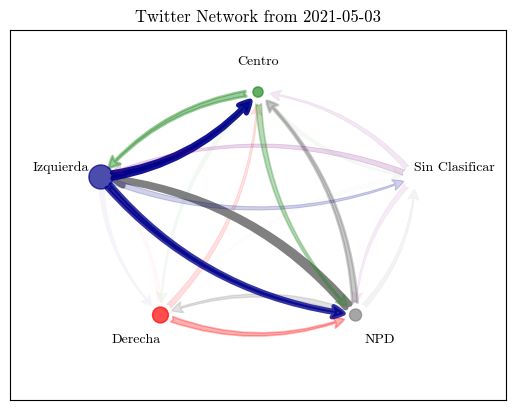

In [83]:
fig, ax = plt.subplots()
G,d = get_minimal_graph('/mnt/disk2/Data/Daily_Graphs/Graphs/starting_2021-05-03.graphml',filter=False)
plot_minimal_no_self_loops(G,d,ax)

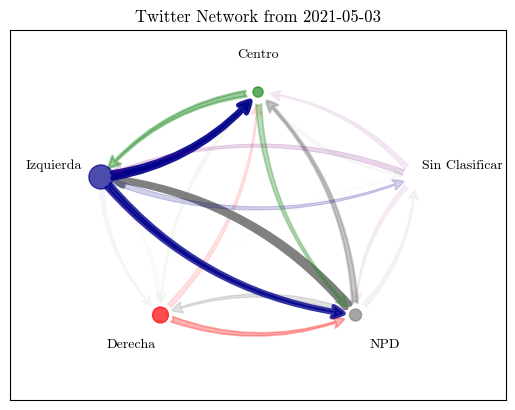

In [91]:
fig, ax = plt.subplots()
# Filtrando NPD
#G,d = get_minimal_graph('/mnt/disk2/Data/Daily_Graphs/Graphs/starting_2021-05-03.graphml',filter=True)
plot_minimal_no_self_loops(G,d,ax)

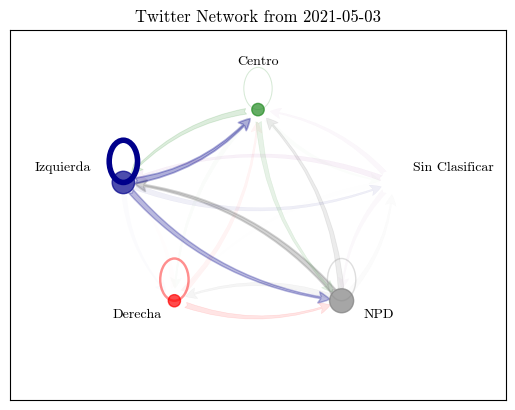

In [90]:
fig, ax = plt.subplots()
plot_minimal_tweets(G,d,ax)

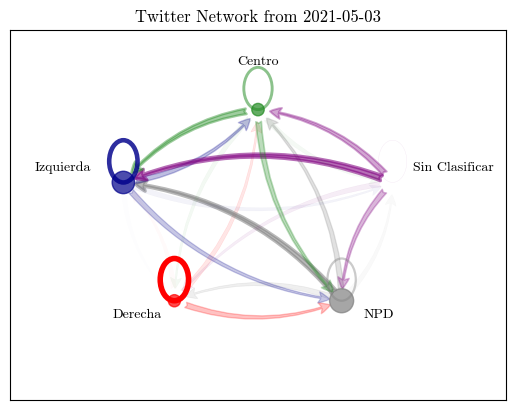

In [74]:
fig, ax = plt.subplots()
# Filtrando NPD
G,d = get_minimal_graph('/mnt/disk2/Data/Daily_Graphs/Graphs/starting_2021-05-03.graphml',filter=False)
plot_minimal_tweets(G,d,ax,share_weights=True)

In [92]:
def save_to_pil(file,filter):
    
    ### MINIMAL GRAPH CON SELF LOOPS
    fig, ax = plt.subplots()
    G,d = get_minimal_graph(file,filter=filter)
    plot_minimal_tweets(G,d,ax)
    plt.close(fig)
    
    # Save the matplotlib figure to a PIL Image object
    buf = io.BytesIO()
    fig.savefig(buf, format='jpg')
    buf.seek(0)
    img_tweet = Image.open(buf)
    
    ### MINIMAL GRAPH SIN SELF LOOPS
    fig, ax = plt.subplots()
    G,d = get_minimal_graph(file,filter=filter)
    plot_minimal_no_self_loops(G,d,ax)
    plt.close(fig)
    
    # Save the matplotlib figure to a PIL Image object
    buf = io.BytesIO()
    fig.savefig(buf, format='jpg')
    buf.seek(0)
    img_no_self_loop = Image.open(buf)
    
    fig, ax = plt.subplots()
    G,d = get_minimal_graph(file,filter=filter)
    plot_minimal_tweets(G,d,ax,share_weights=True)
    plt.close(fig)
    
    # Save the matplotlib figure to a PIL Image object
    buf = io.BytesIO()
    fig.savefig(buf, format='jpg')
    buf.seek(0)
    img_share_weights = Image.open(buf)
    
    return d, img_tweet, img_no_self_loop, img_share_weights

def main(files,filters):
    with ProcessPoolExecutor() as executor:
        images = list(tqdm(executor.map(save_to_pil, files, filters), total=len(files), desc="Creando imagenes", unit='Images'))
    return images

In [93]:
if __name__=='__main__':
    # Files for animation
    files = sorted(glob('/mnt/disk2/Data/Daily_Graphs/Graphs/*.graphml'))
    
    for filter in [True,False]:
        filter_name = 'minimal_animations_no_filter'
        filter_list = [False]*len(files)
        if filter:
            filter_name = 'minimal_animations_filter'
            filter_list = [True]*len(files)
        # Start Non filter animations
        tic = perf_counter()
        images = main(files,filter_list)
        toc = perf_counter()
        time = toc-tic
        
        print(f"Imagenes terminadas en {time//60} minutes and {time%60:,.0f} secs.")
        imgs_tweets = [x[1] for x in sorted(images, key=lambda x: x[0])]
        imgs_no_self_loop = [x[2] for x in sorted(images, key=lambda x: x[0])]
        img_share_weights = [x[3] for x in sorted(images, key=lambda x: x[0])]
        
        imgs_tweets[0].save(f'../Results/Daily_graphs_Viz/{filter_name}/minimal_graph.gif',
                            save_all=True, append_images=imgs_tweets[1:], optimize=False, duration=250, loop=0)
        imgs_no_self_loop[0].save(f'../Results/Daily_graphs_Viz/{filter_name}/minimal_graph_no_self_loop.gif',
                                save_all=True, append_images=imgs_no_self_loop[1:], optimize=False, duration=250, loop=0)
        img_share_weights[0].save(f'../Results/Daily_graphs_Viz/{filter_name}/minimal_graph_img_share_weights.gif',
                                save_all=True, append_images=img_share_weights[1:], optimize=False, duration=250, loop=0)

Creando imagenes: 100%|██████████| 63/63 [01:04<00:00,  1.03s/Images]


Imagenes terminadas en 1.0 minutes and 5 secs.


Creando imagenes: 100%|██████████| 63/63 [01:46<00:00,  1.70s/Images]


Imagenes terminadas en 1.0 minutes and 47 secs.


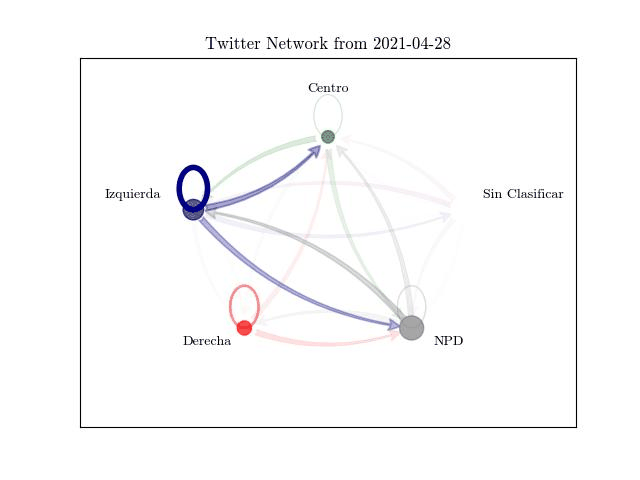

In [94]:
IPImage('../Results/Daily_graphs_Viz/minimal_animations_no_filter/minimal_graph.gif')

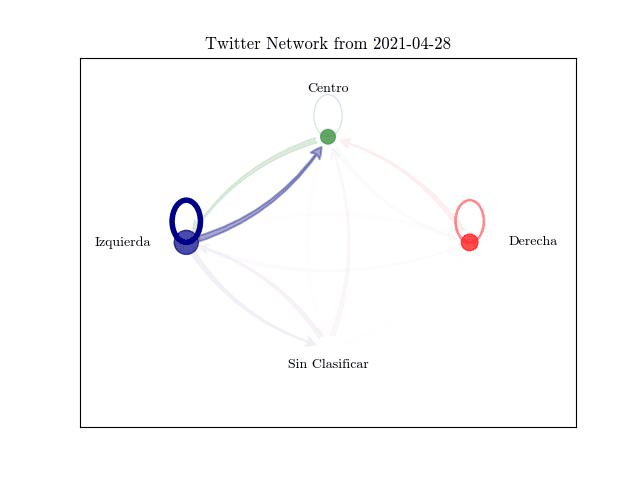

In [95]:
IPImage('../Results/Daily_graphs_Viz/minimal_animations_filter/minimal_graph.gif')

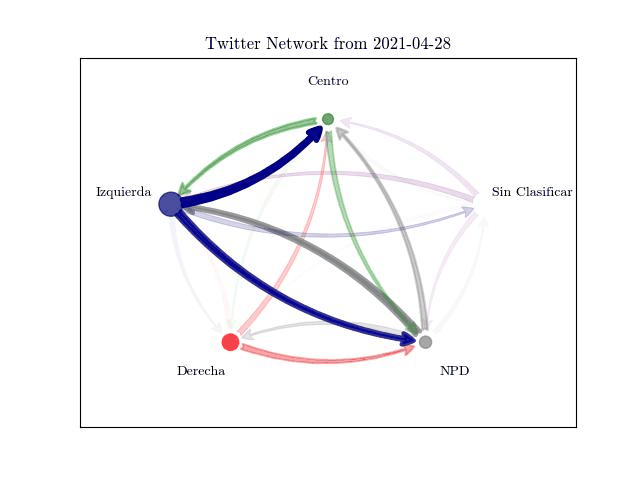

In [96]:
IPImage("../Results/Daily_graphs_Viz/minimal_animations_no_filter/minimal_graph_no_self_loop.gif")

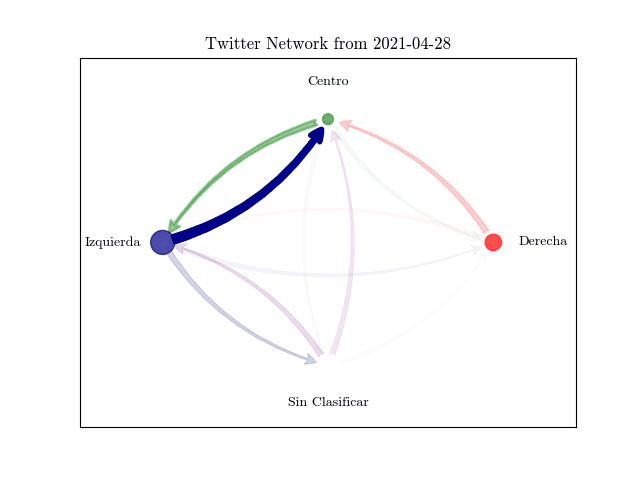

In [97]:
IPImage("../Results/Daily_graphs_Viz/minimal_animations_filter/minimal_graph_no_self_loop.gif")

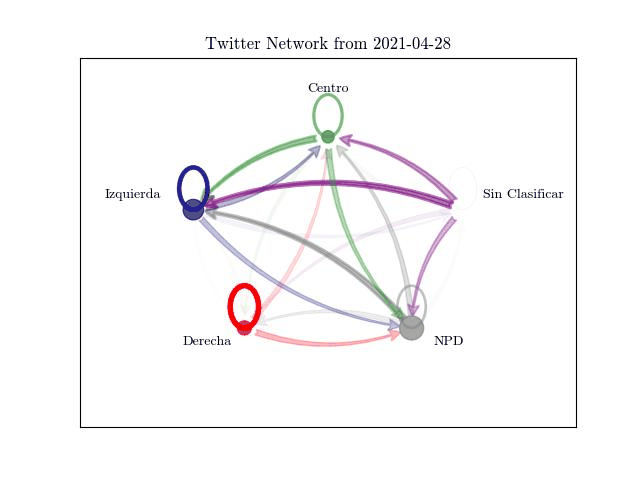

In [98]:
IPImage("../Results/Daily_graphs_Viz/minimal_animations_no_filter/minimal_graph_img_share_weights.gif")

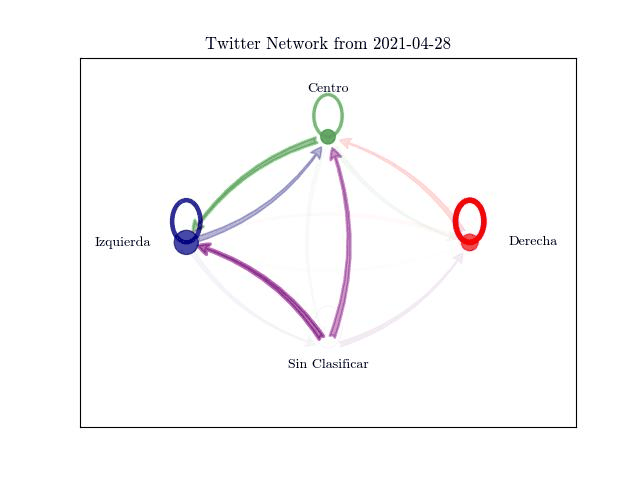

In [99]:
IPImage("../Results/Daily_graphs_Viz/minimal_animations_filter/minimal_graph_img_share_weights.gif")